[[[0.4953363  0.48561648 0.5079341  ... 0.6188102  0.6427947  0.5323816 ]
  [0.4953363  0.49871695 0.49477968 ... 0.6188102  0.6427947  0.5323816 ]
  [       nan 0.5121164  0.49477968 ... 0.6202994  0.61317843 0.48943716]
  ...
  [       nan 0.34410003 0.29497465 ...        nan 0.51259154 0.37609905]
  [       nan 0.35888597 0.31742176 ...        nan 0.59628737 0.40528032]
  [       nan 0.36278763 0.32426906 ... 0.61098063 0.59628737 0.40528032]]

 [[       nan 0.48561648 0.44940144 ... 0.6672579  0.69644374 0.5075408 ]
  [0.4558664  0.4972919  0.49093825 ... 0.61626744 0.6255385  0.55707294]
  [0.4558664  0.4972919  0.5008695  ... 0.61626744 0.61317843 0.498337  ]
  ...
  [       nan 0.34701684 0.2826997  ... 0.5366074  0.55528086        nan]
  [       nan 0.37788448 0.33473802 ... 0.5366074  0.55528086 0.40528032]
  [       nan 0.37788448 0.32426906 ... 0.6066866  0.599761   0.40528032]]

 [[       nan 0.48573473 0.49168527 ... 0.6579123  0.69644374 0.54884744]
  [0.52876514 0.496522

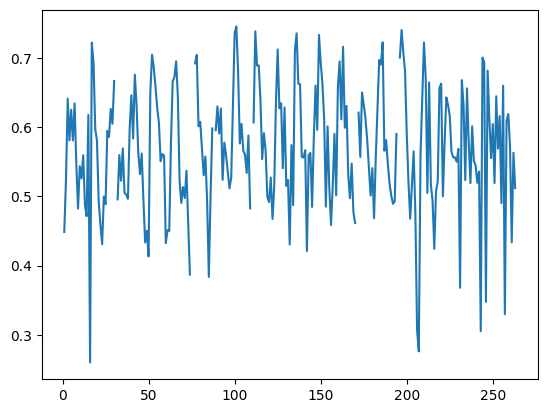

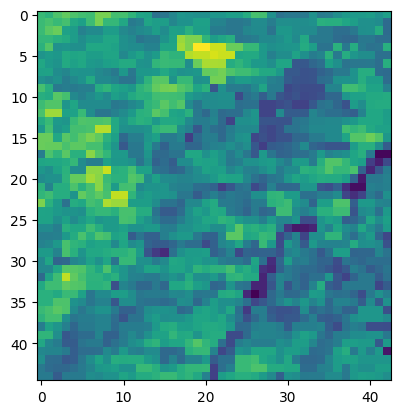

In [ ]:
import matplotlib.pyplot as plt
import tifffile as tiff
import numpy as np


# The Image has 264 Months and 45 X 43 Pixeles
img = tiff.imread('/content/MODMYD09cloud_EVImax_2000_2022_CLM.tiff')
print(img)


# After reshaping the image from 2d (45X43) to 1d (1935) we can print the time series of any one pixel
img2 = np.reshape(img,(-1,264))


fig, axs = plt.subplots()
axs.plot(img2[400,:])




fig2, axs2 = plt.subplots()
axs2.imshow(img[0:45,0:43,200])

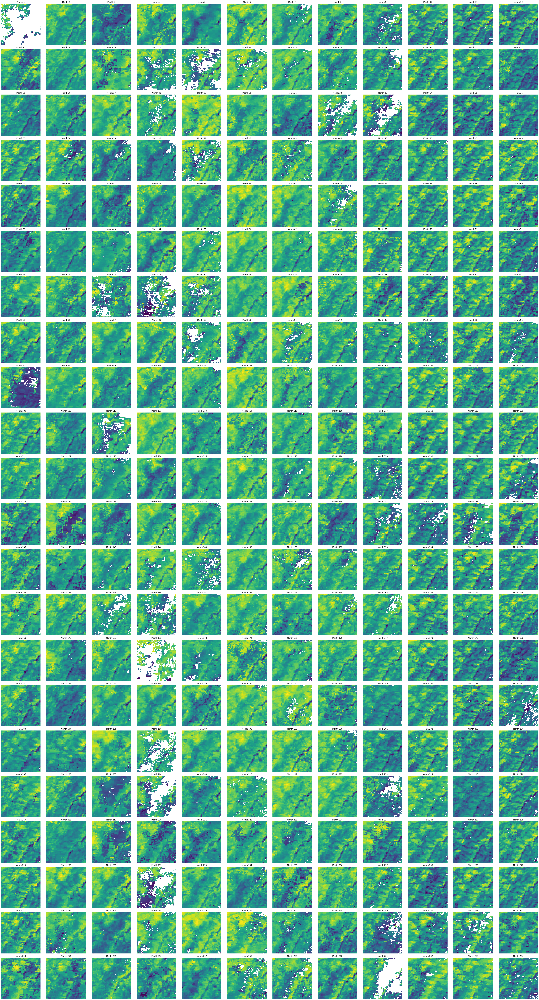

In [ ]:
# Printing each image year wise
import tifffile
import matplotlib.pyplot as plt

# Replace 'your_image.tif' with the path to your time series satellite image file in TIFF format
image_path = '/content/MODMYD09cloud_EVImax_2000_2022_CLM.tiff'

# Open the TIFF image file
image_stack = tifffile.imread(image_path)

# Get the number of time steps (months)
num_time_steps = image_stack.shape[2]

# Set the size of each individual subplot
subfig_size = (4,4)

# Calculate the number of rows and columns for the subplot grid
num_cols = 12  # You can adjust the number of columns based on your preference
num_rows = (num_time_steps // num_cols) + (num_time_steps % num_cols > 0)

# Create a figure with subplots for each time step
fig, axes = plt.subplots(num_rows, num_cols, figsize=(subfig_size[0] * num_cols, subfig_size[1] * num_rows))

# Loop through each time step and plot the corresponding image
for i in range(num_rows):
    for j in range(num_cols):
        index = i * num_cols + j
        if index < num_time_steps:
            axes[i, j].imshow(image_stack[:, :, index], cmap='viridis')
            axes[i, j].set_title(f'Month {index + 1}')
            axes[i, j].axis('off')  # Turn off axis labels for clarity

# Adjust layout to prevent clipping of titles
plt.tight_layout()

# Show the plot
plt.show()

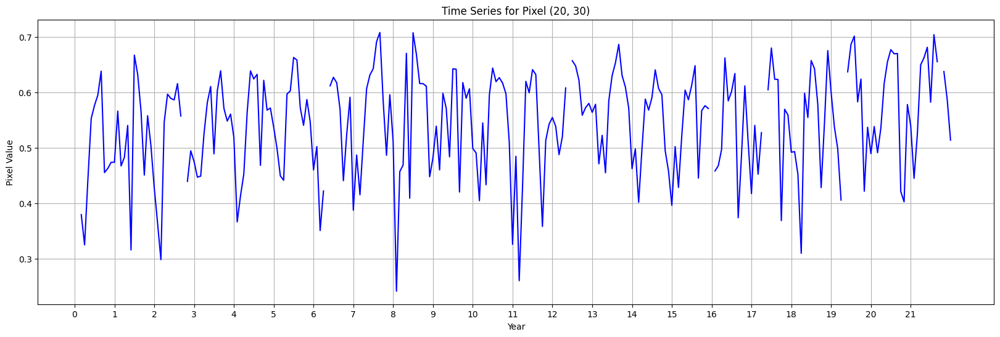

In [ ]:
# Get the dimensions of the image stack
height, width, num_time_steps = image_stack.shape

# Choose a specific pixel location (replace these with the coordinates of the pixel you're interested in)
pixel_row = 20
pixel_col = 30

# Extract the time series for the chosen pixel
pixel_values = image_stack[pixel_row, pixel_col, :]

# Calculate the x-axis values in years
months_per_year = 12
years = np.arange(1, num_time_steps + 1) / months_per_year

# Plot the time series
plt.figure(figsize=(20, 6))
plt.plot(years, pixel_values, linestyle='-', color='b')
plt.title(f'Time Series for Pixel ({pixel_row}, {pixel_col})')
plt.xlabel('Year')
plt.ylabel('Pixel Value')
plt.grid(True)

plt.xticks(range(0,22))


plt.show()


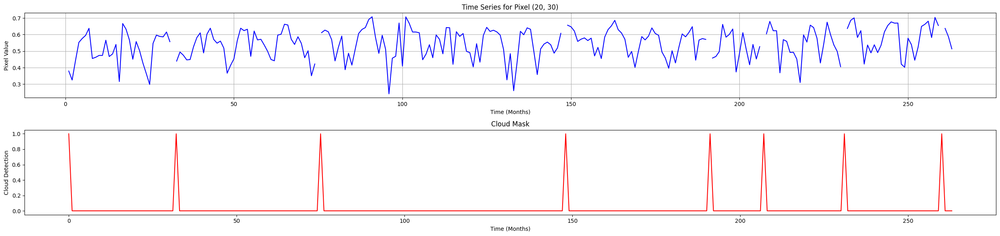

In [ ]:
# Choose a specific pixel location (replace these with the coordinates of the pixel you're interested in)
pixel_row = 20
pixel_col = 30
# Extract the time series for the chosen pixel
pixel_values = image_stack[pixel_row, pixel_col, :]

# Threshold for cloud detection (adjust as needed)
cloud_threshold = 0.2

# Calculate the Normalized Difference Vegetation Index (NDVI) for cloud detection
red_band = image_stack[pixel_row, pixel_col, :]
nir_band = image_stack[pixel_row, pixel_col, :]
ndvi = (nir_band - red_band) / (nir_band + red_band)

# Create a binary mask where clouds are identified as True
cloud_mask = ndvi < cloud_threshold
cloud_mask = ~cloud_mask
# 1 - Cloud Detected
# 0 - Cloud Not Detected

# Plot the time series for the chosen pixel with cloud detection
plt.figure(figsize=(25, 6))

plt.subplot(2, 1, 1)
plt.plot(pixel_values,  linestyle='-', color='b')
plt.title(f'Time Series for Pixel ({pixel_row}, {pixel_col})')
plt.xlabel('Time (Months)')
plt.ylabel('Pixel Value')
plt.grid(True)

plt.tight_layout()

plt.subplot(2, 1, 2)
plt.plot(cloud_mask, linestyle='-', color='r')
plt.title('Cloud Mask')
plt.xlabel('Time (Months)')
plt.ylabel('Cloud Detection')


plt.tight_layout()
plt.show()

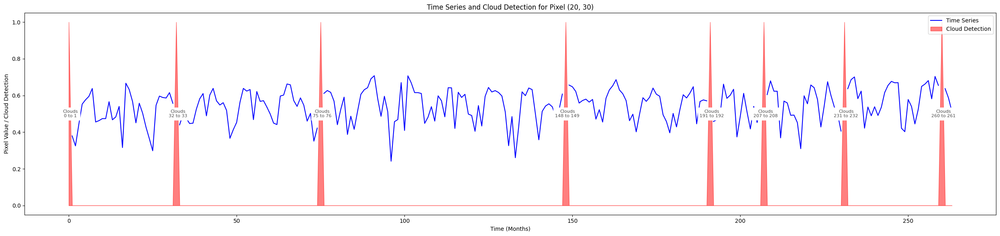

In [ ]:
# Choose a specific pixel location (replace these with the coordinates of the pixel you're interested in)
pixel_row = 20
pixel_col = 30

# Extract the time series for the chosen pixel
pixel_values = image_stack[pixel_row, pixel_col, :]

# Threshold for cloud detection (adjust as needed)
cloud_threshold = 0.2

# Calculate the Normalized Difference Vegetation Index (NDVI) for cloud detection
red_band = image_stack[pixel_row, pixel_col, :]
nir_band = image_stack[pixel_row, pixel_col, :]
ndvi = (nir_band - red_band) / (nir_band + red_band)

# Create a binary mask where clouds are identified as True
cloud_mask = ndvi < cloud_threshold

# Invert the cloud mask (1 where clouds are detected, 0 otherwise)
cloud_mask = ~cloud_mask

# Plot both the time series and cloud detection on the same set of axes
plt.figure(figsize=(25, 6))

# Plot the time series
plt.plot(pixel_values,  linestyle='-', color='b', label='Time Series')

# Plot the inverted cloud detection using a filled area plot
plt.fill_between(np.arange(len(cloud_mask)), 0, cloud_mask.astype(int), color='r', alpha=0.5, label='Cloud Detection')

# Add labels and title
plt.title(f'Time Series and Cloud Detection for Pixel ({pixel_row}, {pixel_col})')
plt.xlabel('Time (Months)')
plt.ylabel('Pixel Value / Cloud Detection')
plt.legend()  # Show legend to distinguish between the two lines

# Annotate periods of cloud detection
in_cloud = False
for i, is_cloudy in enumerate(cloud_mask):
    if is_cloudy and not in_cloud:
        in_cloud = True
        start_period = i
    elif not is_cloudy and in_cloud:
        in_cloud = False
        end_period = i
        plt.annotate(f'Clouds\n{start_period} to {end_period}', xy=(start_period + (end_period - start_period) / 2, 0.5),
                     ha='center', va='center', backgroundcolor='white', fontsize=8, color='black', alpha=0.7)

plt.tight_layout()
plt.show()

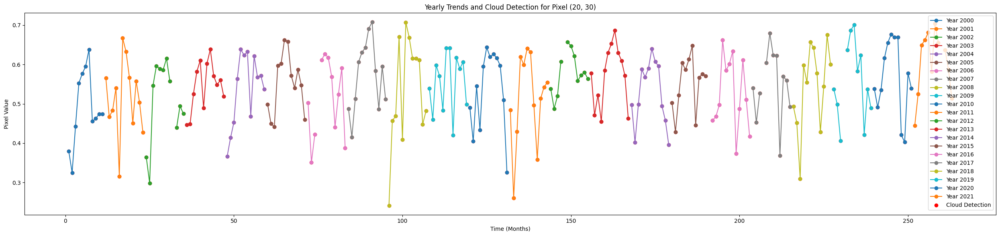

In [ ]:
# Choose a specific pixel location (replace these with the coordinates of the pixel you're interested in)
pixel_row = 20
pixel_col = 30

# Extract the time series for the chosen pixel
pixel_values = image_stack[pixel_row, pixel_col, :]

# Threshold for cloud detection (adjust as needed)
cloud_threshold = 0.2

# Calculate the Normalized Difference Vegetation Index (NDVI) for cloud detection
red_band = image_stack[pixel_row, pixel_col, :]
nir_band = image_stack[pixel_row, pixel_col, :]
ndvi = (nir_band - red_band) / (nir_band + red_band)

# Create a binary mask where clouds are identified as True (1) and areas without clouds as False (0)
cloud_mask = ndvi < cloud_threshold

# Find the start and end indices of each year
years = np.arange(2000, 2023)  # Assuming the time series starts in 2000
yearly_segments = [(i, i + 12) for i in range(0, len(pixel_values), 12)]

# Plot each year's trend separately
plt.figure(figsize=(25, 6))

for start, end in yearly_segments:
    plt.plot(range(start, end), pixel_values[start:end], marker='o', linestyle='-', label=f'Year {years[start // 12]}')

# Highlight areas with clouds
plt.scatter(np.where(cloud_mask), pixel_values[cloud_mask], color='red', marker='o', label='Cloud Detection')

# Add labels and title
plt.title(f'Yearly Trends and Cloud Detection for Pixel ({pixel_row}, {pixel_col})')
plt.xlabel('Time (Months)')
plt.ylabel('Pixel Value')
plt.legend()

plt.tight_layout()
plt.show()

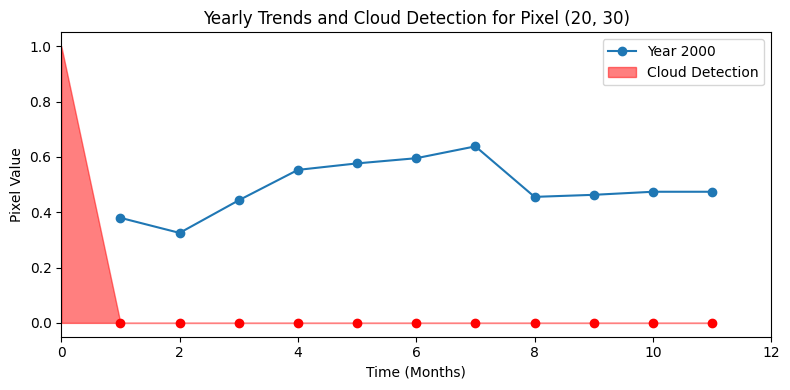

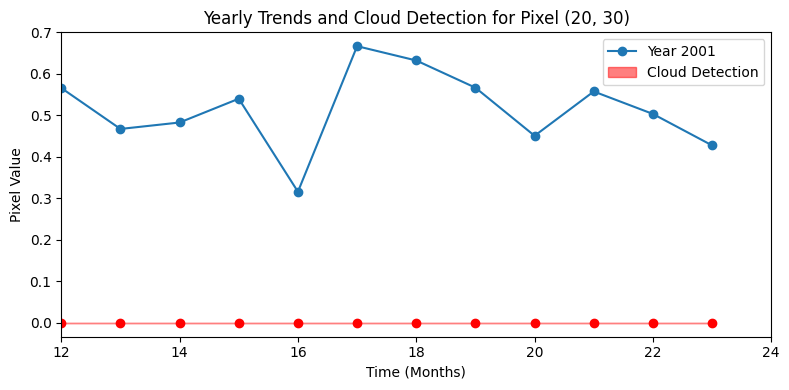

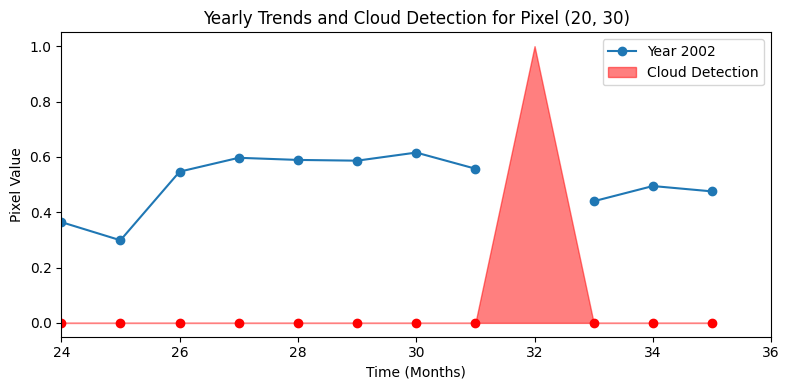

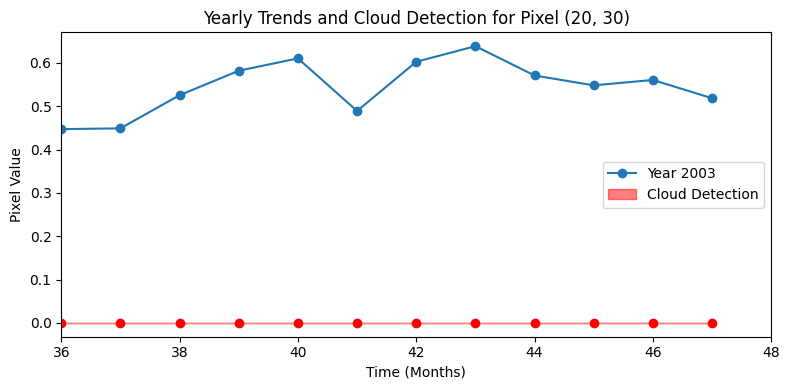

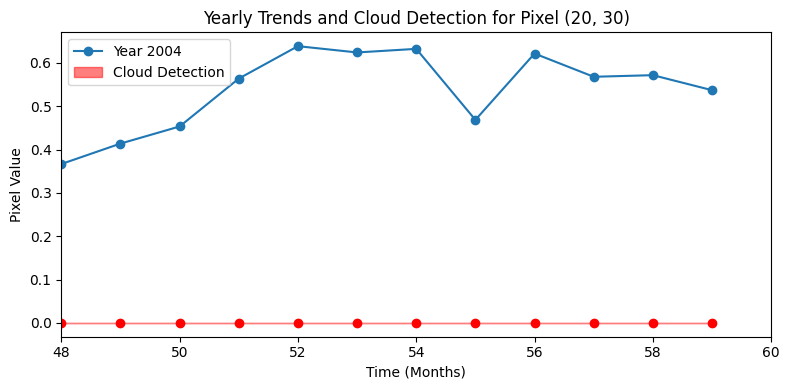

...

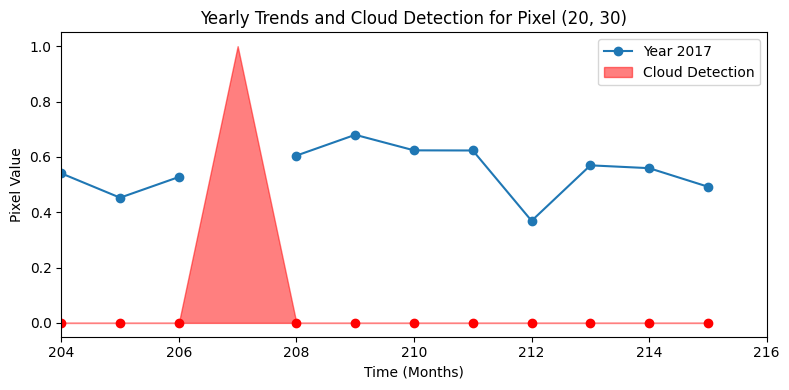

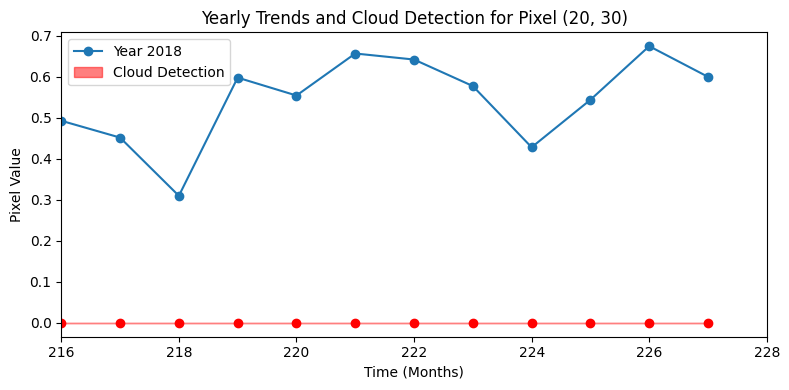

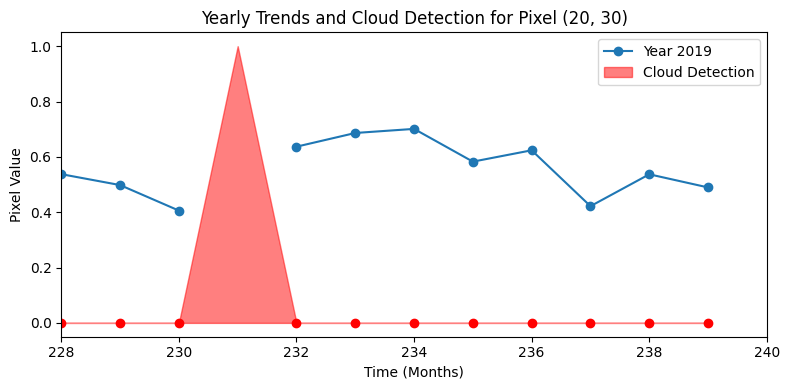

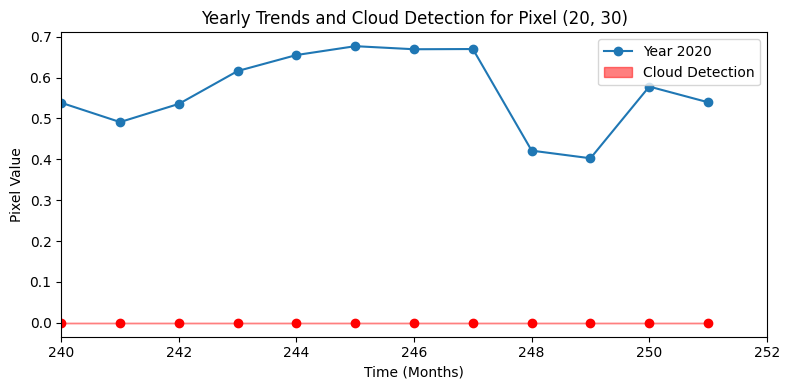

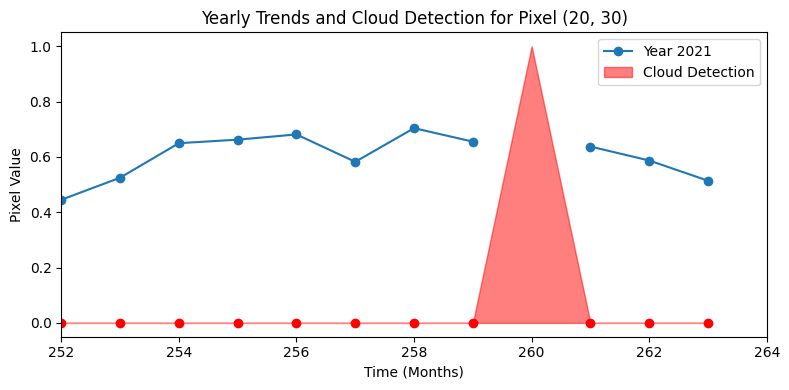

In [ ]:
# Choose a specific pixel location (replace these with the coordinates of the pixel you're interested in)
pixel_row = 20
pixel_col = 30

# Extract the time series for the chosen pixel
pixel_values = image_stack[pixel_row, pixel_col, :]

# Threshold for cloud detection (adjust as needed)
cloud_threshold = 0.2

# Calculate the Normalized Difference Vegetation Index (NDVI) for cloud detection
red_band = image_stack[pixel_row, pixel_col, :]
nir_band = image_stack[pixel_row, pixel_col, :]
ndvi = (nir_band - red_band) / (nir_band + red_band)

# Create a binary mask where clouds are identified as True (1) and areas without clouds as False (0)
cloud_mask = ndvi < cloud_threshold
cloud_mask = ~cloud_mask

# Find the start and end indices of each year
years = np.arange(2000, 2023)  # Assuming the time series starts in 2000
yearly_segments = [(i, i + 12) for i in range(0, len(pixel_values), 12)]

# Analyze trends for each year
for i, (start, end) in enumerate(yearly_segments, 1):
    plt.figure(figsize=(8, 4))

    # Plot VI (Vegetation Index)
    plt.plot(range(start, end), pixel_values[start:end], marker='o', linestyle='-', label=f'Year {years[start // 12]}')

    # Plot Cloud Detection
    plt.scatter(np.arange(start, end), pixel_values[start:end] * cloud_mask[start:end],
                color='red', marker='o')

    plt.fill_between(np.arange(start, end), 0, cloud_mask[start:end].astype(int), color='r', alpha=0.5, label='Cloud Detection')

    # Set x-axis limits to match the VI graph
    plt.xlim(start, end)

    # Add labels and title
    plt.title(f'Yearly Trends and Cloud Detection for Pixel ({pixel_row}, {pixel_col})')
    plt.xlabel('Time (Months)')
    plt.ylabel('Pixel Value')
    plt.legend()

    plt.tight_layout()
    plt.show()

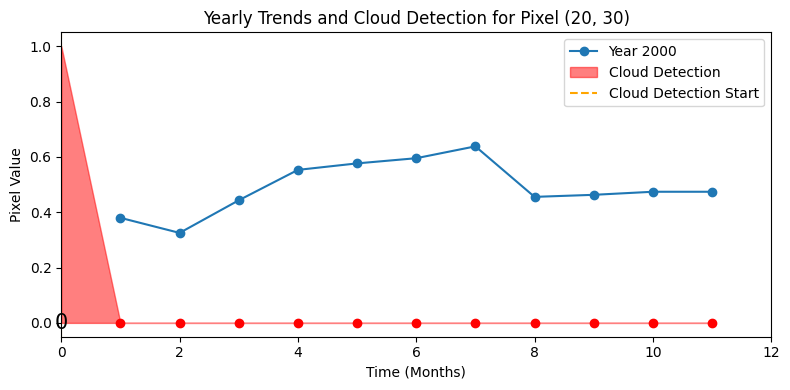

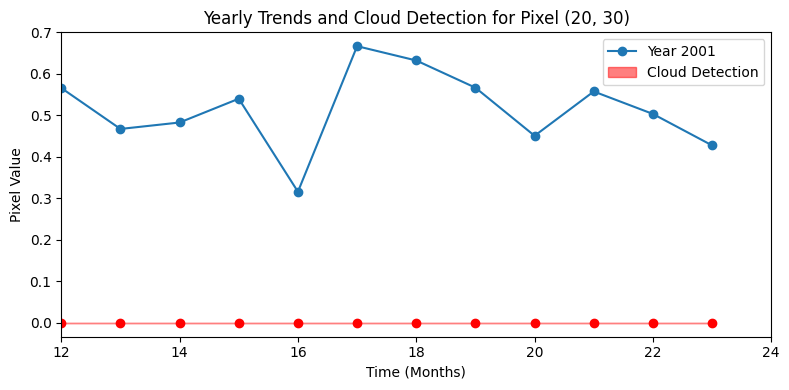

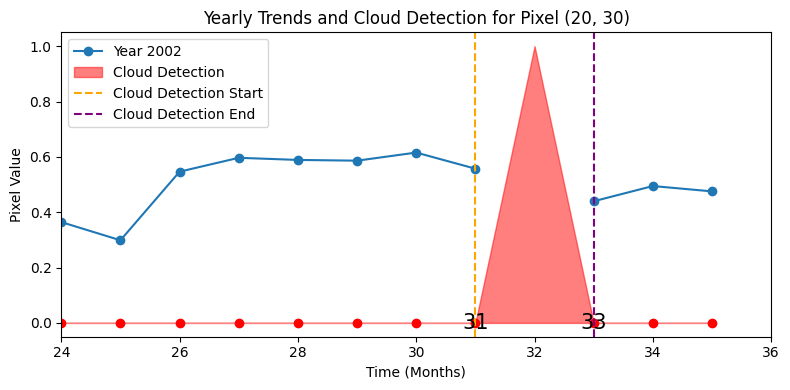

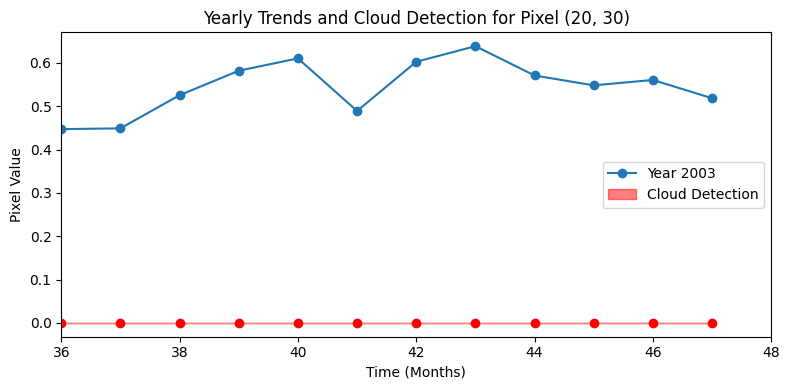

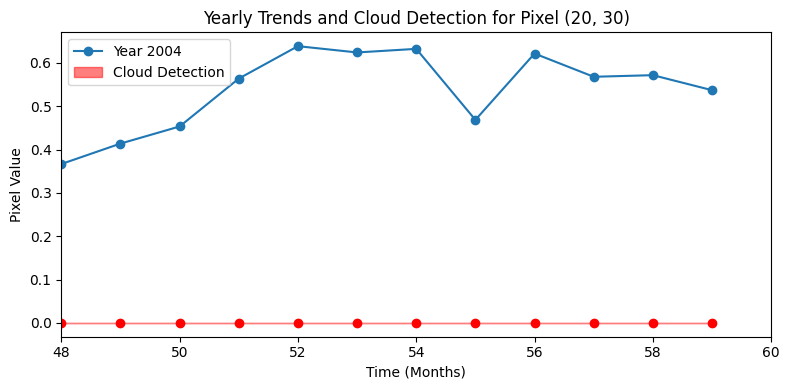

...

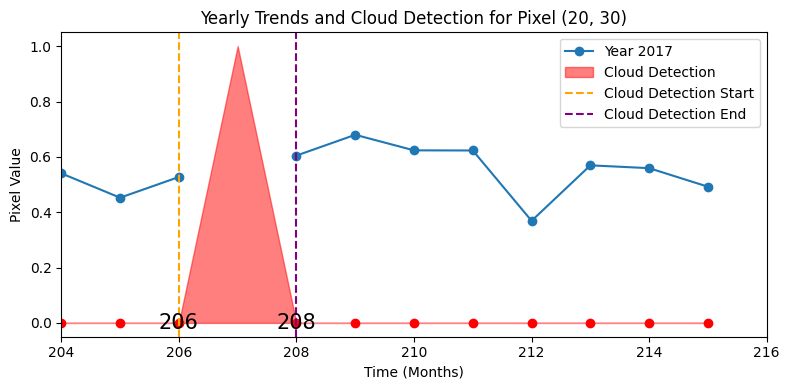

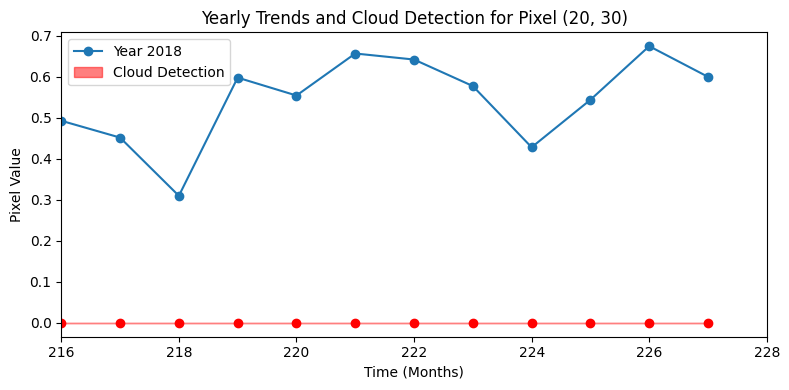

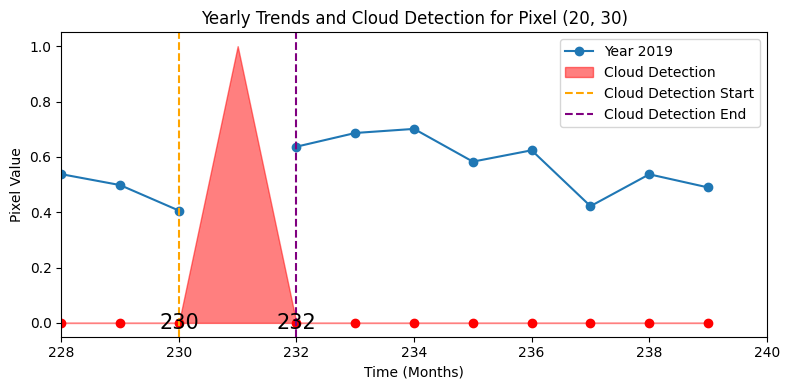

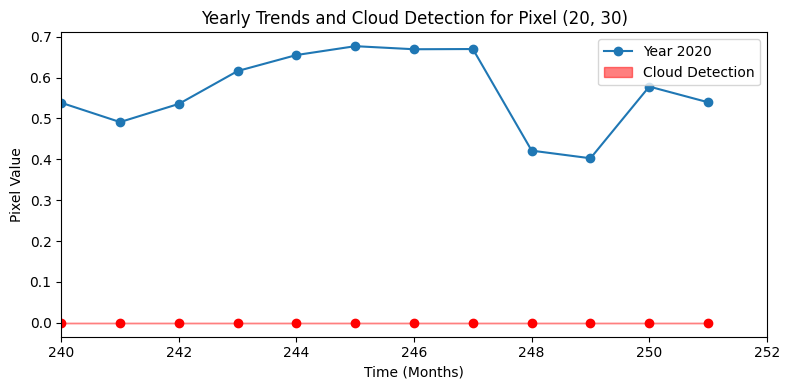

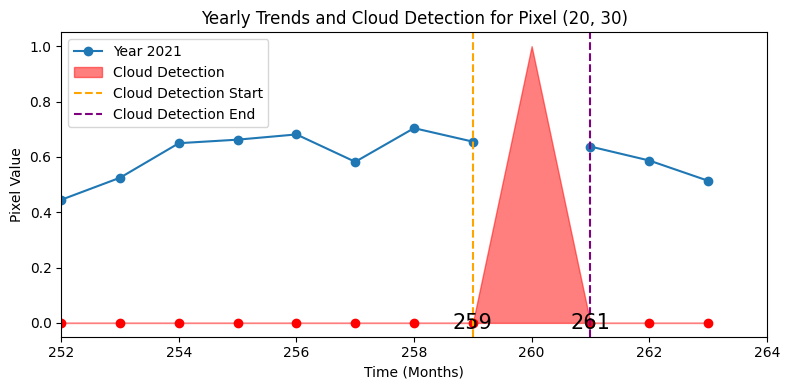

In [ ]:
# Choose a specific pixel location (replace these with the coordinates of the pixel you're interested in)
pixel_row = 20
pixel_col = 30

# Extract the time series for the chosen pixel
pixel_values = image_stack[pixel_row, pixel_col, :]

# Threshold for cloud detection (adjust as needed)
cloud_threshold = 0.2

# Calculate the Normalized Difference Vegetation Index (NDVI) for cloud detection
red_band = image_stack[pixel_row, pixel_col, :]
nir_band = image_stack[pixel_row, pixel_col, :]
ndvi = (nir_band - red_band) / (nir_band + red_band)

# Create a binary mask where clouds are identified as True (1) and areas without clouds as False (0)
cloud_mask = ndvi < cloud_threshold
cloud_mask = ~cloud_mask

# Find the start and end indices of each year
years = np.arange(2000, 2023)  # Assuming the time series starts in 2000
yearly_segments = [(i, i + 12) for i in range(0, len(pixel_values), 12)]

# Analyze trends for each year
for i, (start, end) in enumerate(yearly_segments, 1):
    plt.figure(figsize=(8, 4))

    # Plot VI (Vegetation Index)
    plt.plot(range(start, end), pixel_values[start:end], marker='o', linestyle='-', label=f'Year {years[start // 12]}')

    # Plot Cloud Detection
    plt.scatter(np.arange(start, end), pixel_values[start:end] * cloud_mask[start:end],
                color='red', marker='o')

    # Fill between the cloud detection points
    plt.fill_between(np.arange(start, end), 0, cloud_mask[start:end].astype(int), color='r', alpha=0.5, label='Cloud Detection')

    # Mark starting and ending coordinates of each detected cloud period
    cloud_segments = np.where(np.diff(cloud_mask[start:end]) != 0)[0]
    for cloud_start, cloud_end in zip(cloud_segments[::2], cloud_segments[1::2]):
        plt.axvline(x=start + cloud_start, color='orange', linestyle='--', label='Cloud Detection Start')
        plt.axvline(x=start + cloud_end + 1, color='purple', linestyle='--', label='Cloud Detection End')

        # Annotate starting and ending x-axis coordinates directly on the graph
        plt.text(start + cloud_start, 0, f'{start + cloud_start}', fontsize=15, ha='center', va='center', color='black')
        plt.text(start + cloud_end + 1, 0, f'{start + cloud_end + 1}', fontsize=15, ha='center', va='center', color='black')

    # Check and handle the edge cases
    if cloud_mask[start] == 1:
        plt.axvline(x=start, color='orange', linestyle='--', label='Cloud Detection Start')
        plt.text(start, 0, f'{start}', fontsize=15, ha='center', va='center', color='black')
    if cloud_mask[end - 1] == 1:
        plt.axvline(x=end - 1, color='purple', linestyle='--', label='Cloud Detection End')
        plt.text(end - 1, 0, f'{end - 1}', fontsize=15, ha='center', va='center', color='black')

    # Set x-axis limits to match the VI graph
    plt.xlim(start, end)

    # Add labels and title
    plt.title(f'Yearly Trends and Cloud Detection for Pixel ({pixel_row}, {pixel_col})')
    plt.xlabel('Time (Months)')
    plt.ylabel('Pixel Value')
    plt.legend()

    plt.tight_layout()
    plt.show()

**Visualizing what is the pixel value for each pixel of an image for a particular month**

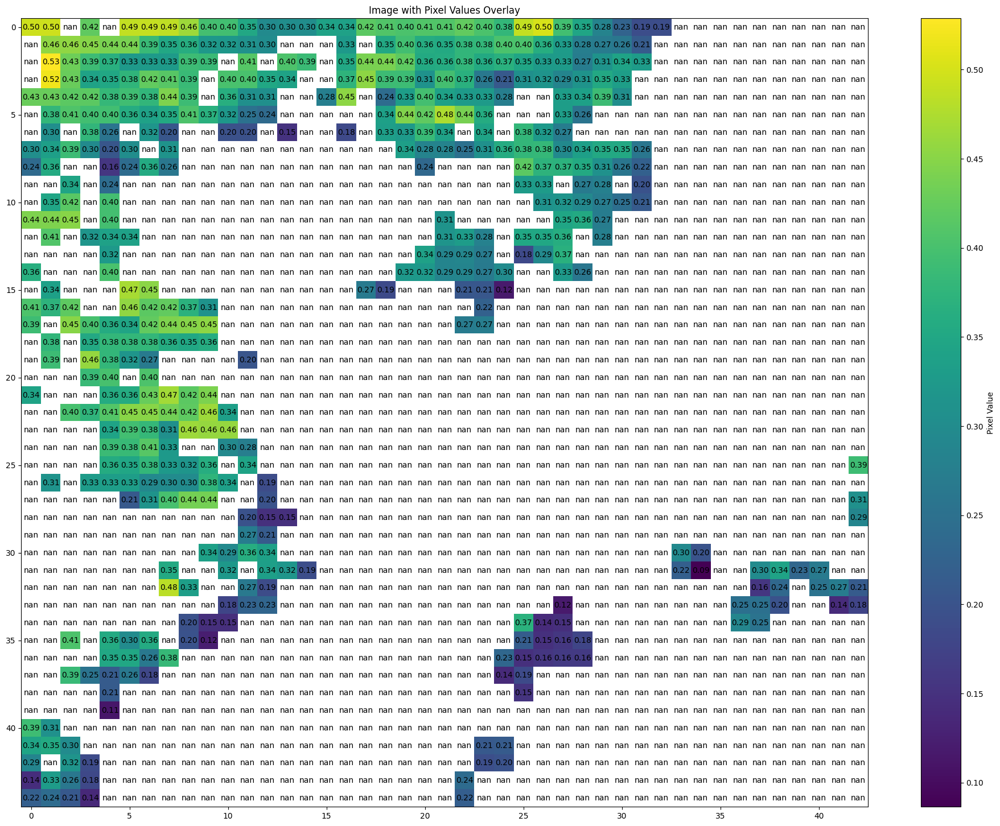

In [ ]:
# Choose a specific month (0-based index)
target_month = 0

# Get the image for the selected month
original_image = image_stack[:, :, target_month]

# Plot the image
plt.figure(figsize=(24, 18))
plt.imshow(original_image, cmap='viridis', aspect='auto')

# Overlay pixel values as text with adjusted size
for i in range(original_image.shape[0]):
    for j in range(original_image.shape[1]):
        plt.text(j, i, f'{original_image[i, j]:.2f}', color='black', ha='center', va='center', fontsize=10)

plt.title('Image with Pixel Values Overlay')
plt.colorbar(label='Pixel Value')
plt.show()


**Filling In the NAN Values with ZERO**

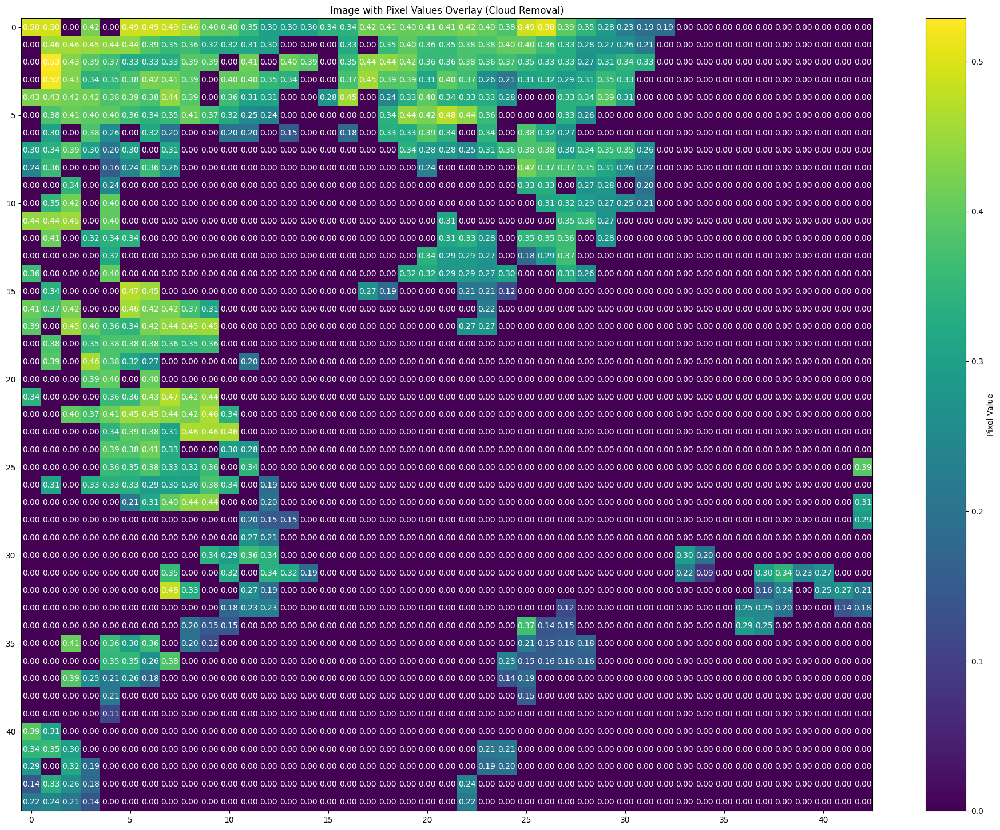

In [ ]:
# Choose a specific month (0-based index)
target_month = 0

# Get the image for the selected month
selected_image_0_value = image_stack[:, :, target_month]

# Fill NaN values with zero
selected_image_0_value = np.nan_to_num(selected_image_0_value, nan=0)

# Plot the image
plt.figure(figsize=(24, 18))
plt.imshow(selected_image_0_value, cmap='viridis', aspect='auto')

# Overlay pixel values as text with adjusted size
for i in range(selected_image_0_value.shape[0]):
    for j in range(selected_image_0_value.shape[1]):
        plt.text(j, i, f'{selected_image_0_value[i, j]:.2f}', color='white', ha='center', va='center', fontsize=10)

plt.title('Image with Pixel Values Overlay (Cloud Removal)')
plt.colorbar(label='Pixel Value')
plt.show()

**Filling In the NAN Values with the average value of every other month where the VALUE is not NAN**

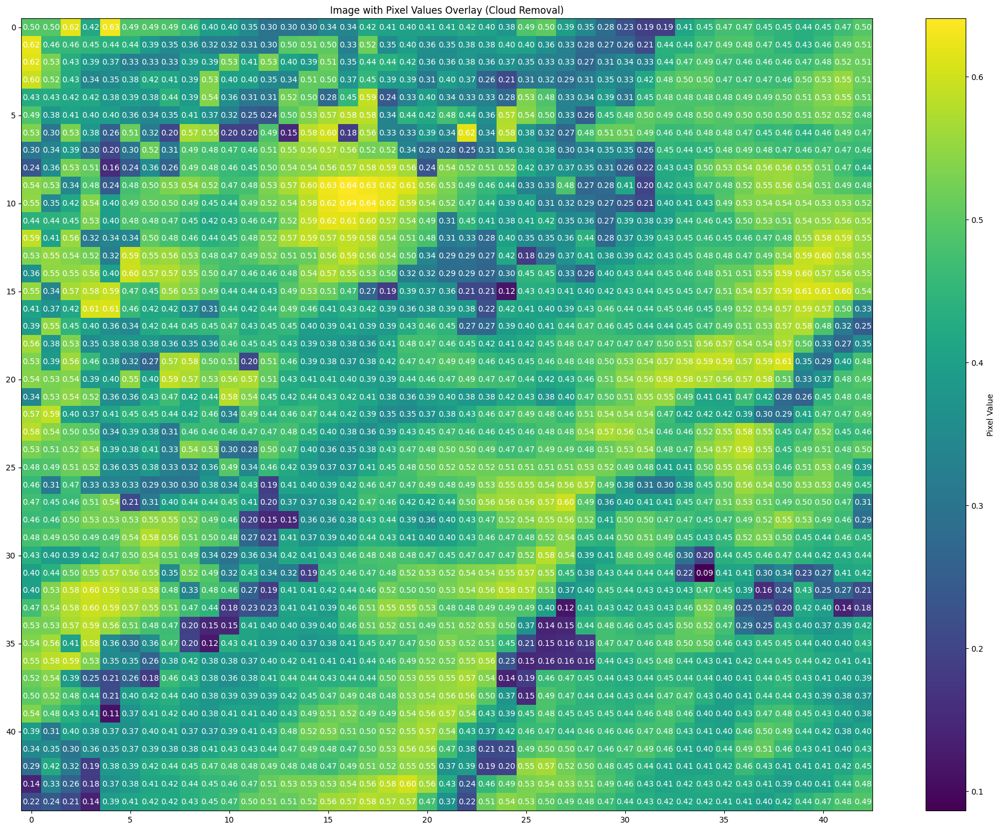

In [ ]:
# Choose a specific month (0-based index)
target_month = 0

# Get the image for the selected month
selected_image = image_stack[:, :, target_month]


# Fill NaN values in the first month by taking the average of non-NaN values in other months
for i in range(selected_image.shape[0]):
    for j in range(selected_image.shape[1]):
        if np.isnan(selected_image[i, j]):
            non_nan_values = image_stack[i, j, 1:]  # Exclude the first month
            non_nan_values = non_nan_values[~np.isnan(non_nan_values)]  # Remove NaN values
            if non_nan_values.size > 0:
                selected_image[i, j] = np.mean(non_nan_values)




# Plot the image
plt.figure(figsize=(24, 18))
plt.imshow(selected_image, cmap='viridis', aspect='auto')

# Overlay pixel values as text with adjusted size
for i in range(selected_image.shape[0]):
    for j in range(selected_image.shape[1]):
        plt.text(j, i, f'{selected_image[i, j]:.2f}', color='white', ha='center', va='center', fontsize=10)

plt.title('Image with Pixel Values Overlay (Cloud Removal)')
plt.colorbar(label='Pixel Value')
plt.show()

**Applying The Above Cloud Removal Process to All the MONTHS IMAGES**

In [ ]:
import numpy as np
# Initialize an array to store the modified images
modified_images = np.empty_like(image_stack)

# Iterate over each month
for target_month in range(image_stack.shape[2]):
    # Get the image for the selected month
    selected_image = image_stack[:, :, target_month]

    # Fill NaN values in the current month by taking the average of non-NaN values in other months
    for i in range(selected_image.shape[0]):
        for j in range(selected_image.shape[1]):
            if np.isnan(selected_image[i, j]):
                non_nan_values = np.concatenate([image_stack[i, j, :target_month], image_stack[i, j, (target_month + 1):]])  # Exclude the current month
                non_nan_values = non_nan_values[~np.isnan(non_nan_values)]  # Remove NaN values
                if non_nan_values.size > 0:
                    selected_image[i, j] = np.mean(non_nan_values)

    # Assign the modified image to the corresponding slice in modified_images
    modified_images[:, :, target_month] = selected_image

# The modified_images array now contains the modified images for each month
# You can access them as needed for further processing or analysis

**Images With Clouds Removed**

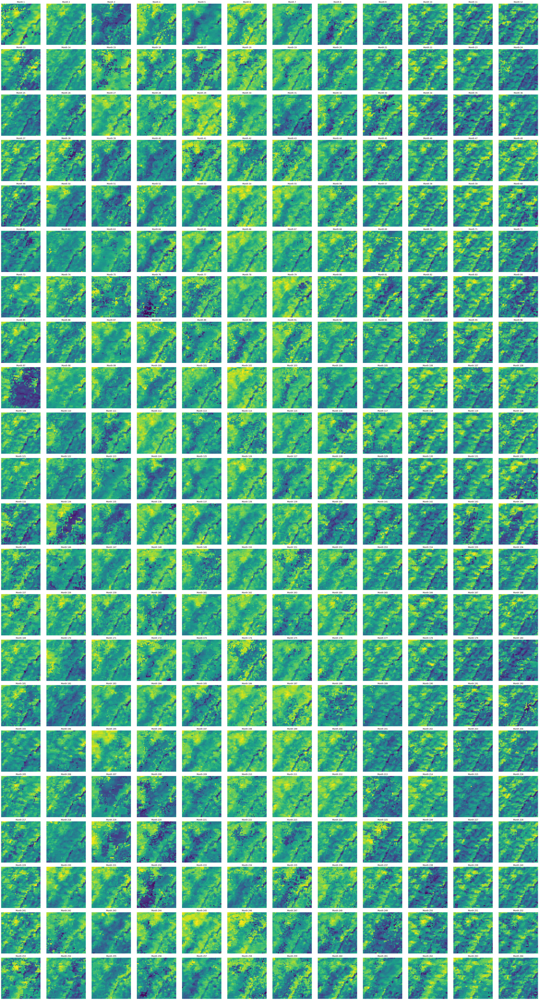

In [ ]:
# Get the number of time steps (months)
num_time_steps = image_stack.shape[2]

# Set the size of each individual subplot
subfig_size = (4,4)  # Adjust as needed

# Calculate the number of rows and columns for the subplot grid
num_cols = 12  # You can adjust the number of columns based on your preference
num_rows = (num_time_steps // num_cols) + (num_time_steps % num_cols > 0)

# Create a figure with subplots for each time step
fig, axes = plt.subplots(num_rows, num_cols, figsize=(subfig_size[0] * num_cols, subfig_size[1] * num_rows))

# Loop through each time step and plot the corresponding image
for i in range(num_rows):
    for j in range(num_cols):
        index = i * num_cols + j
        if index < num_time_steps:
            axes[i, j].imshow(modified_images[:, :, index], cmap='viridis')
            axes[i, j].set_title(f'Month {index + 1}')
            axes[i, j].axis('off')  # Turn off axis labels for clarity

# Adjust layout to prevent clipping of titles
plt.tight_layout()

# Show the plot
plt.show()

**Orginal Time Series Graph - Blue Vs Reconstructed Time Series Graph - Red**

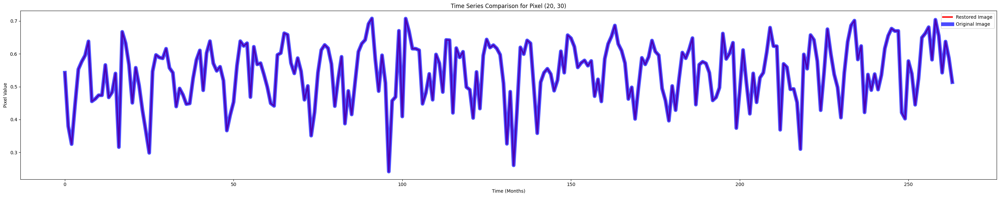

In [ ]:
# Choose a specific pixel location (replace these with the coordinates of the pixel you're interested in)
pixel_row = 20
pixel_col = 30

# Extract the time series for the chosen pixel from both original and modified images
original_pixel_values = image_stack[pixel_row, pixel_col, :]
restored_pixel_values = modified_images[pixel_row, pixel_col, :]

# Plot the time series graphs with adjusted y-axis limits
plt.figure(figsize=(30, 6))

# Plot with thicker lines and transparency
plt.plot(restored_pixel_values, linestyle='-', linewidth=3, color='red', alpha=1, label='Restored Image')
plt.plot(original_pixel_values, linestyle='-', linewidth=8, color='blue', alpha=0.7, label='Original Image')

# Add labels and title
plt.title(f'Time Series Comparison for Pixel ({pixel_row}, {pixel_col})')
plt.xlabel('Time (Months)')
plt.ylabel('Pixel Value')
plt.legend()

plt.tight_layout()
plt.show()

**Comparing The Original Image and Cloud Removed Image Side By Side**

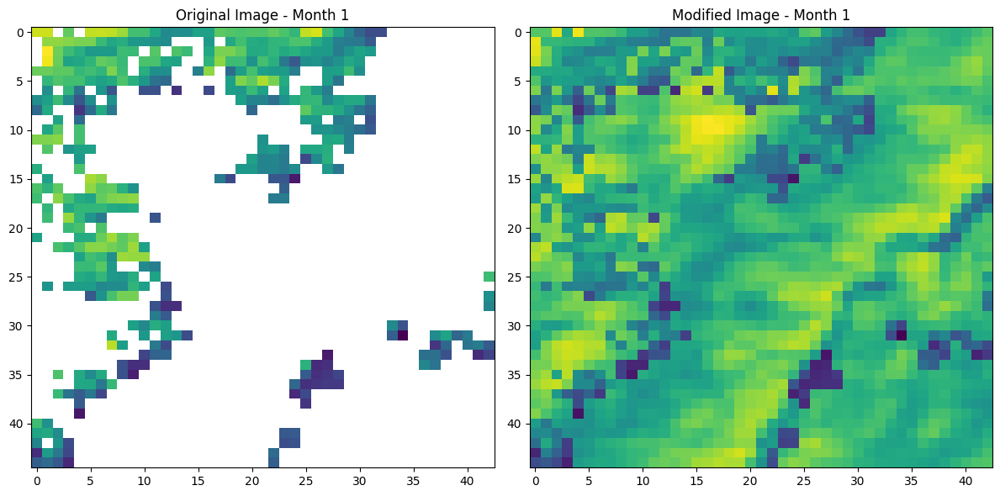

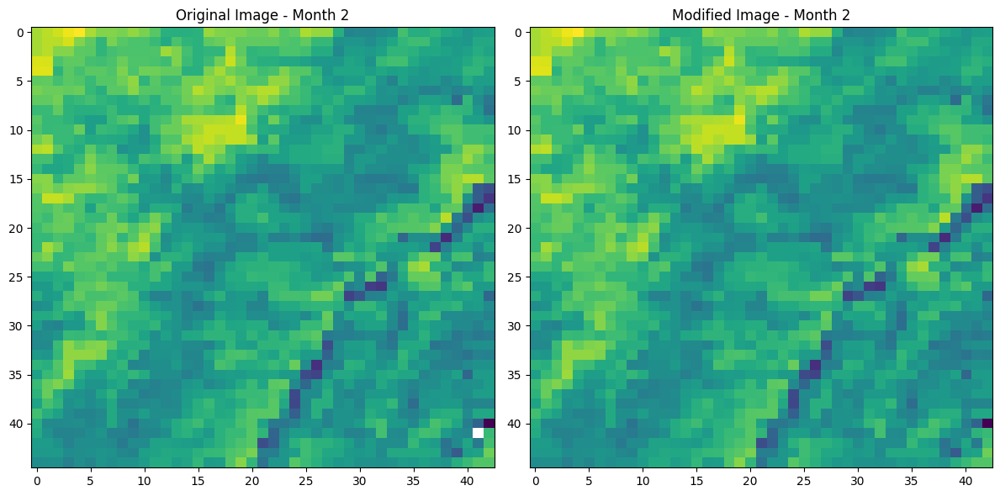

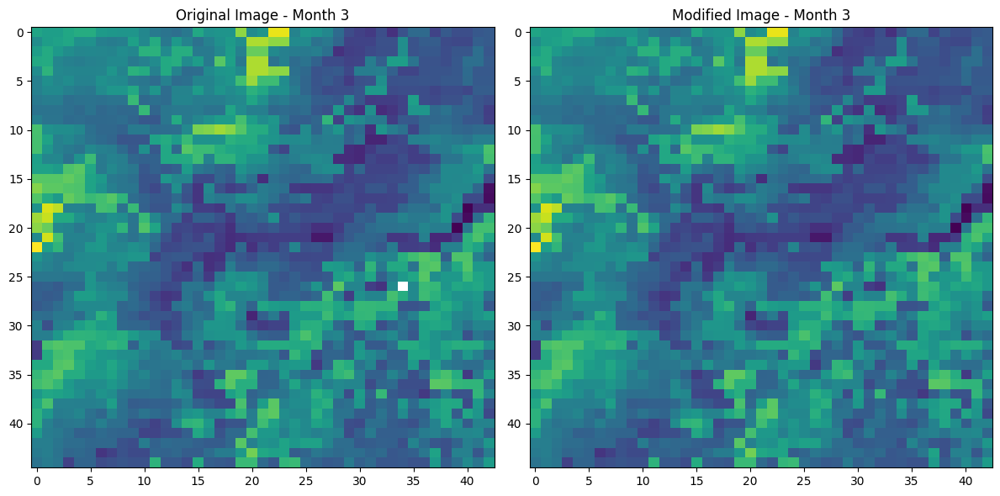

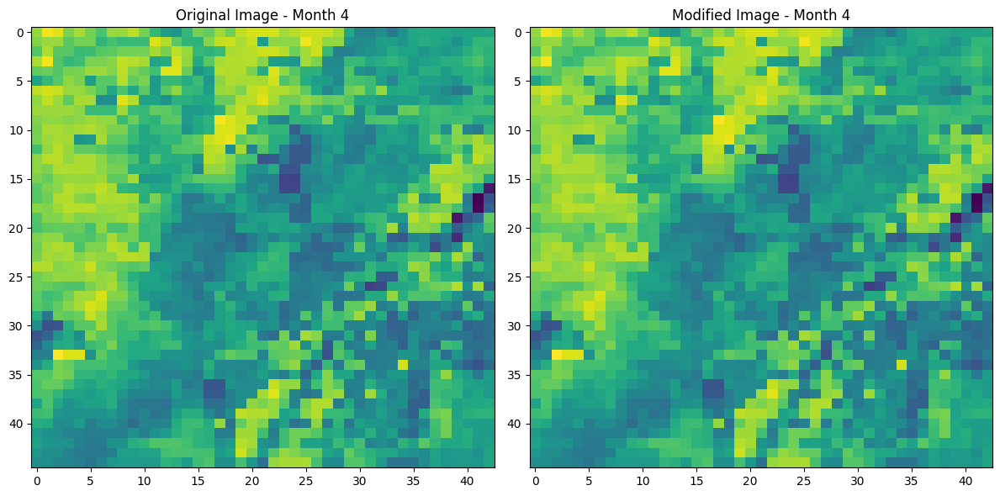

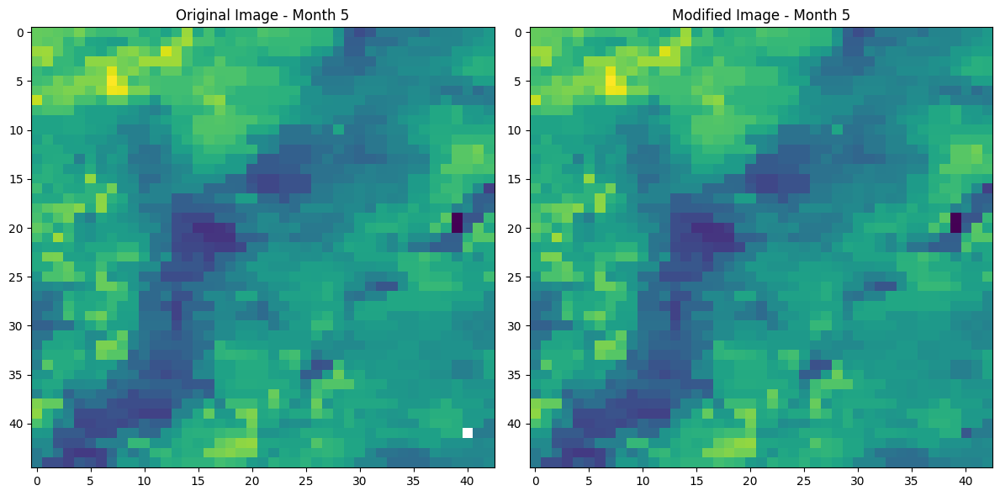

...

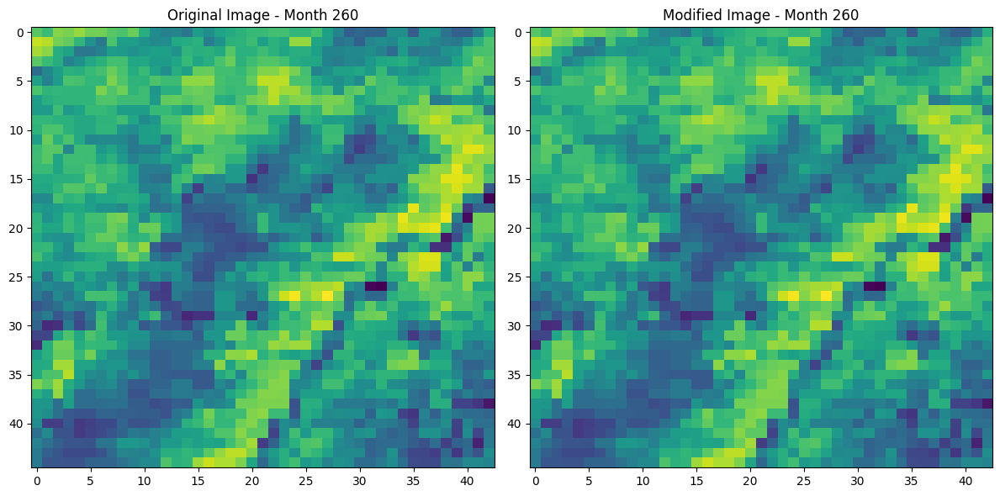

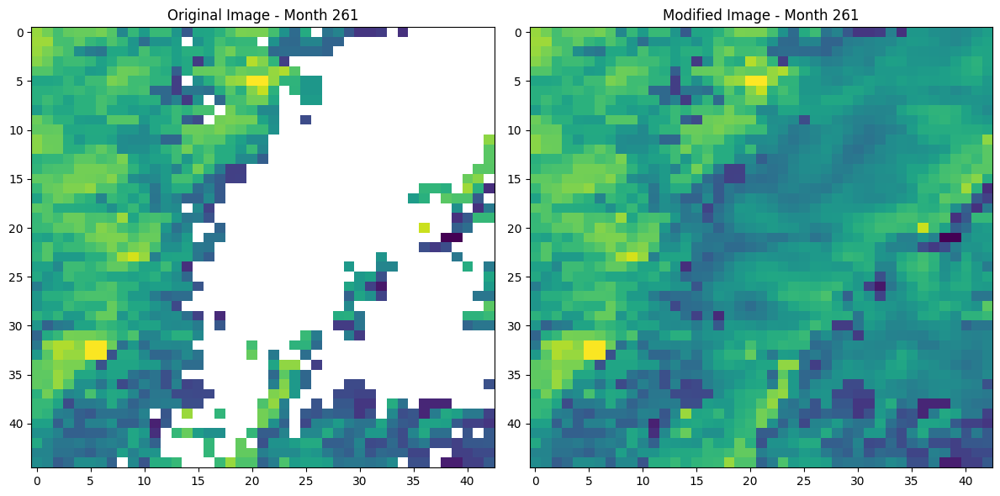

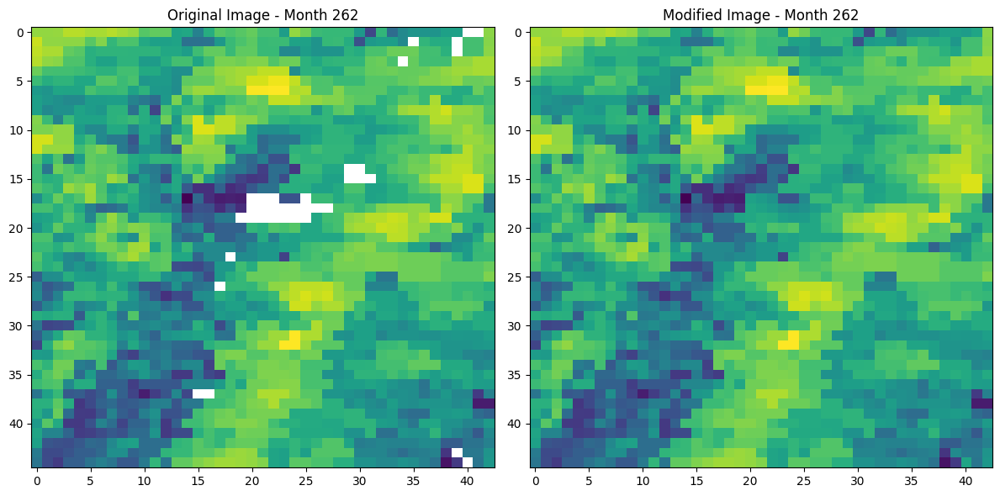

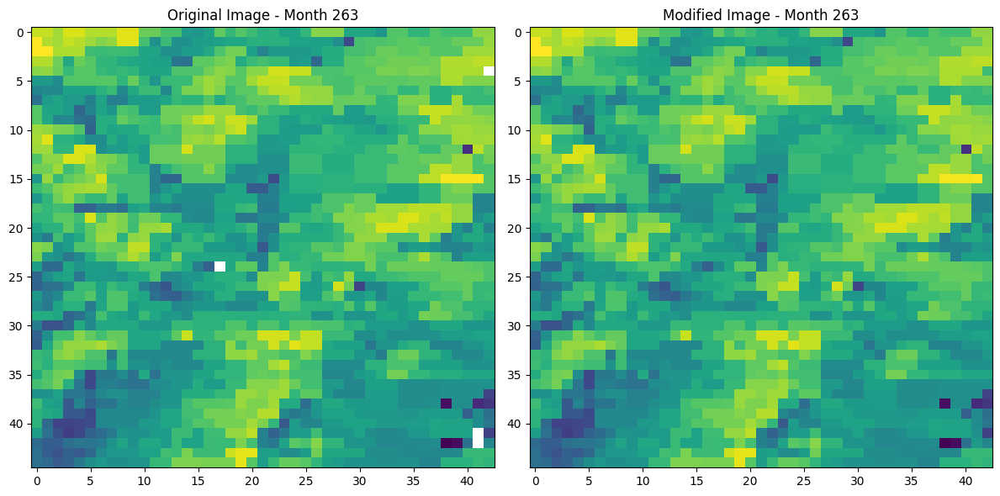

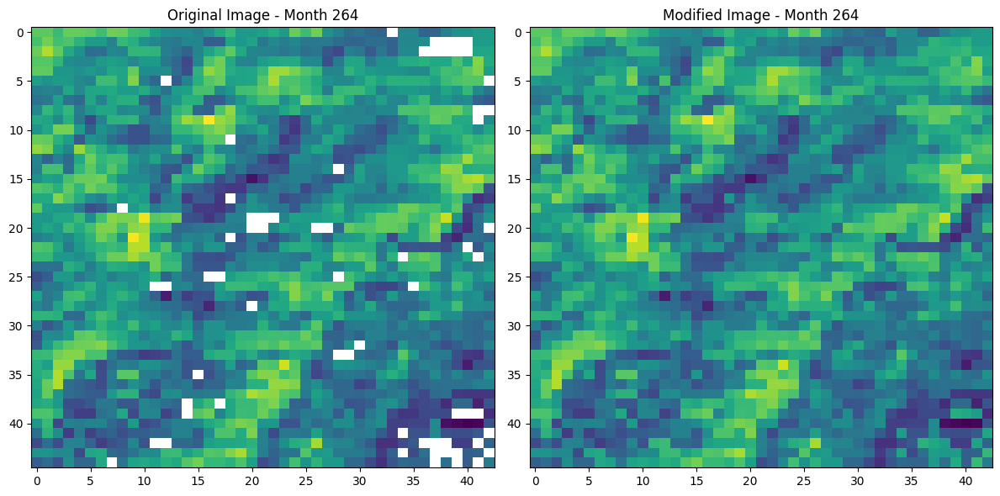

In [ ]:
# Open the TIFF image file
image_stack = tifffile.imread(image_path)

# Assume modified_images has been created and filled as shown in previous code

# Iterate over each month
for target_month in range(image_stack.shape[2]):
    # Get the original and modified images for the selected month
    original_image = image_stack[:, :, target_month]
    modified_image = modified_images[:, :, target_month]

    # Display the original and modified images side by side
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(original_image, cmap='viridis', aspect='auto')
    plt.title(f'Original Image - Month {target_month + 1}')

    plt.subplot(1, 2, 2)
    plt.imshow(modified_image, cmap='viridis', aspect='auto')
    plt.title(f'Modified Image - Month {target_month + 1}')

    plt.tight_layout()
    plt.show()

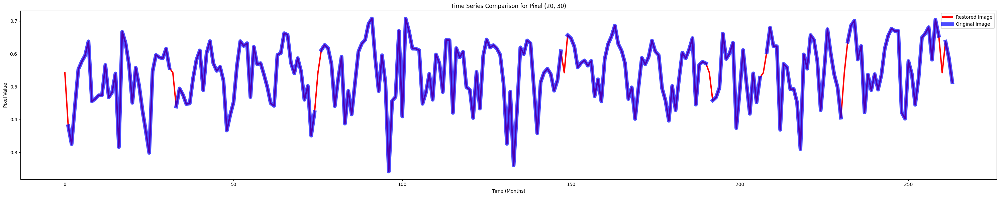

In [ ]:
# Choose a specific pixel location (replace these with the coordinates of the pixel you're interested in)
pixel_row = 20
pixel_col = 30

# Extract the time series for the chosen pixel from both original and modified images
original_pixel_values = image_stack[pixel_row, pixel_col, :]
restored_pixel_values = modified_images[pixel_row, pixel_col, :]

# Plot the time series graphs with adjusted y-axis limits
plt.figure(figsize=(30, 6))

# Plot with thicker lines and transparency
plt.plot(restored_pixel_values, linestyle='-', linewidth=3, color='red', alpha=1, label='Restored Image')
plt.plot(original_pixel_values, linestyle='-', linewidth=8, color='blue', alpha=0.7, label='Original Image')

# Add labels and title
plt.title(f'Time Series Comparison for Pixel ({pixel_row}, {pixel_col})')
plt.xlabel('Time (Months)')
plt.ylabel('Pixel Value')
plt.legend()

plt.tight_layout()
plt.show()

**Month 2 & 3**

**Interpolation**

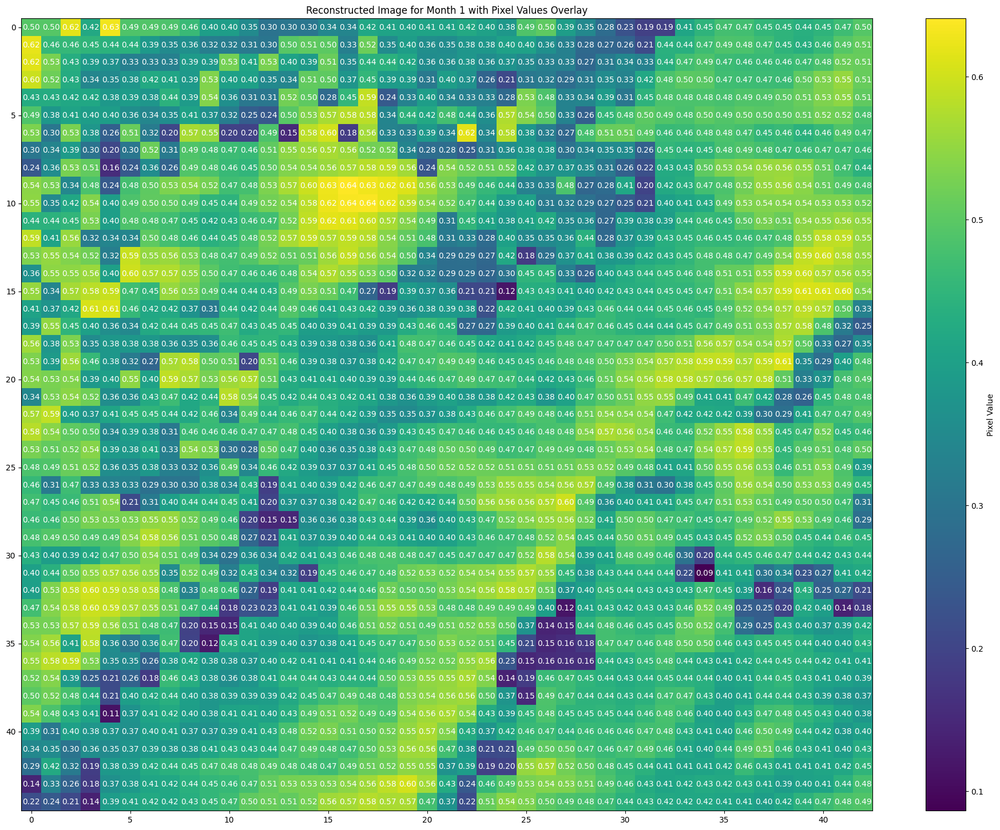

In [ ]:
# Choose a specific month (0-based index)
target_month = 0

# Reconstruct the image by interpolating NaN values
reconstructed_image = np.empty_like(image_stack)
for i in range(image_stack.shape[0]):
    for j in range(image_stack.shape[1]):
        pixel_values = image_stack[i, j, :]
        non_nan_indices = ~np.isnan(pixel_values)
        if np.sum(non_nan_indices) > 1:
            reconstructed_image[i, j, :] = np.interp(np.arange(len(pixel_values)), np.arange(len(pixel_values))[non_nan_indices], pixel_values[non_nan_indices])
        else:
            # If only one non-NaN value or all NaN, keep the original values
            reconstructed_image[i, j, :] = pixel_values

# Plot the reconstructed image for the selected month
plt.figure(figsize=(24, 18))
plt.imshow(reconstructed_image[:, :, target_month], cmap='viridis', aspect='auto')

# Overlay pixel values as text with adjusted size
for i in range(reconstructed_image.shape[0]):
    for j in range(reconstructed_image.shape[1]):
        plt.text(j, i, f'{reconstructed_image[i, j, target_month]:.2f}', color='white', ha='center', va='center', fontsize=10)

plt.title(f'Reconstructed Image for Month {target_month + 1} with Pixel Values Overlay')
plt.colorbar(label='Pixel Value')
plt.show()

**Interpolation methods can estimate missing values based on the values of neighboring months, providing a more continuous representation of the time series.**

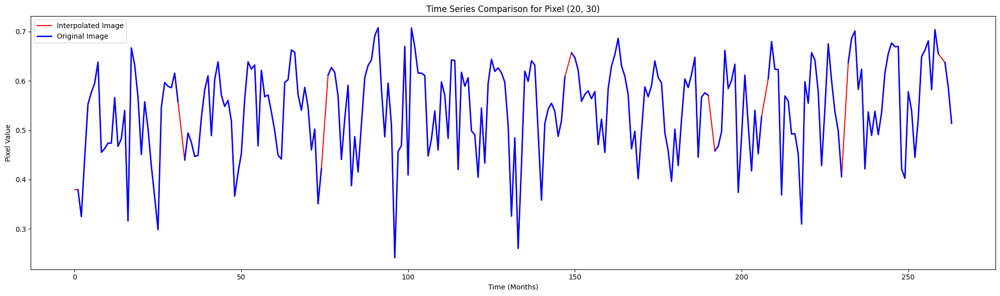

In [ ]:
import numpy as np
# Interpolate NaN values along the time axis for each pixel
interpolated_images = np.empty_like(image_stack)
for i in range(image_stack.shape[0]):
    for j in range(image_stack.shape[1]):
        pixel_values = image_stack[i, j, :]
        non_nan_indices = ~np.isnan(pixel_values)
        if np.sum(non_nan_indices) > 1:
            interpolated_images[i, j, :] = np.interp(np.arange(len(pixel_values)), np.arange(len(pixel_values))[non_nan_indices], pixel_values[non_nan_indices])
        else:
            # If only one non-NaN value or all NaN, keep the original values
            interpolated_images[i, j, :] = pixel_values

# Visualize the original and interpolated time series for a specific pixel
pixel_row = 20
pixel_col = 30

original_pixel_values = image_stack[pixel_row, pixel_col, :]
interpolated_pixel_values = interpolated_images[pixel_row, pixel_col, :]

plt.figure(figsize=(20, 6))
plt.plot(interpolated_pixel_values, linestyle='-', color='r', label='Interpolated Image')
plt.plot(original_pixel_values, linestyle='-', linewidth=2,color='b', label='Original Image')
# plt.plot(restored_pixel_values, linestyle='-', linewidth=3, color='green', alpha=0.6, label='Restored Image')
plt.title(f'Time Series Comparison for Pixel ({pixel_row}, {pixel_col})')
plt.xlabel('Time (Months)')
plt.ylabel('Pixel Value')
plt.legend()
plt.tight_layout()
plt.show()

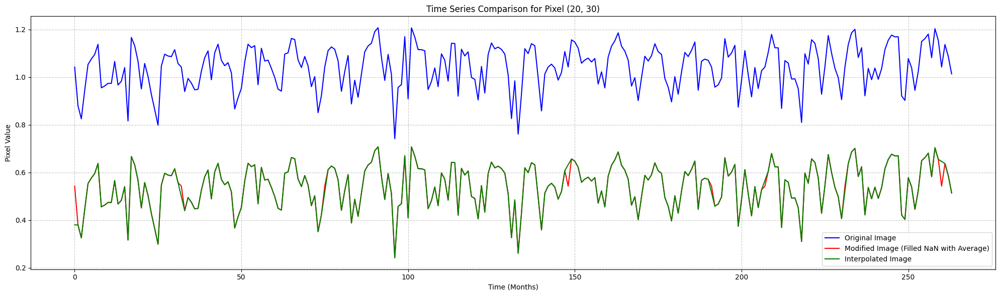

In [ ]:
# Choose a specific pixel location (replace these with the coordinates of the pixel you're interested in)
pixel_row = 20
pixel_col = 30

# Extract the time series for the chosen pixel from original, modified, and interpolated images
original_pixel_values = image_stack[pixel_row, pixel_col, :]
modified_pixel_values = modified_images[pixel_row, pixel_col, :]
interpolated_pixel_values = interpolated_images[pixel_row, pixel_col, :]

# Plot all three time series on the same graph with vertical offsets
plt.figure(figsize=(20, 6))

# Plot original time series
plt.plot(original_pixel_values+0.5, linestyle='-', color='b', label='Original Image')

# Plot modified time series (filled NaN with average) with a small vertical offset
plt.plot(modified_pixel_values , linestyle='-', color='r', label='Modified Image (Filled NaN with Average)')

# Plot interpolated time series with a larger vertical offset
plt.plot(interpolated_pixel_values , linestyle='-', color='g', label='Interpolated Image')

# Add grid lines
plt.grid(True, linestyle='--', alpha=0.7)

# Add labels and title
plt.title(f'Time Series Comparison for Pixel ({pixel_row}, {pixel_col})')
plt.xlabel('Time (Months)')
plt.ylabel('Pixel Value')
plt.legend()

plt.tight_layout()
plt.show()

**Interpreting and visualizing the VI value month wise for 22 years**

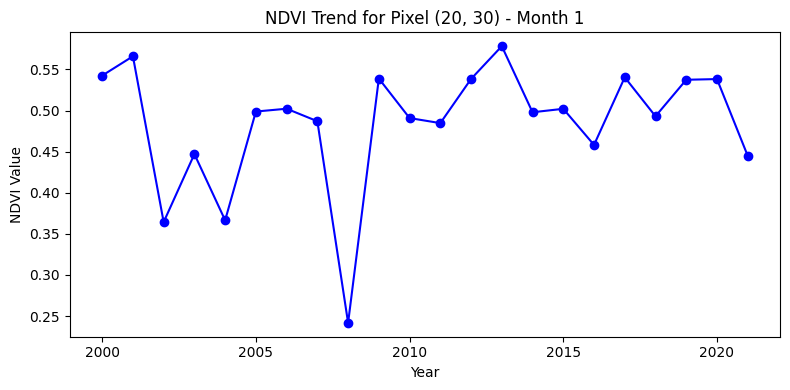

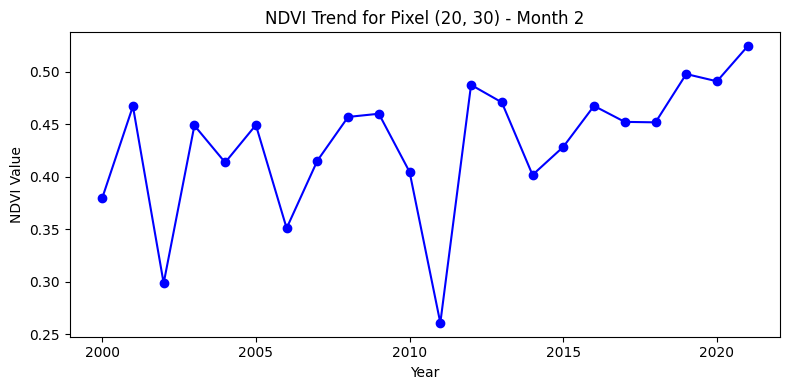

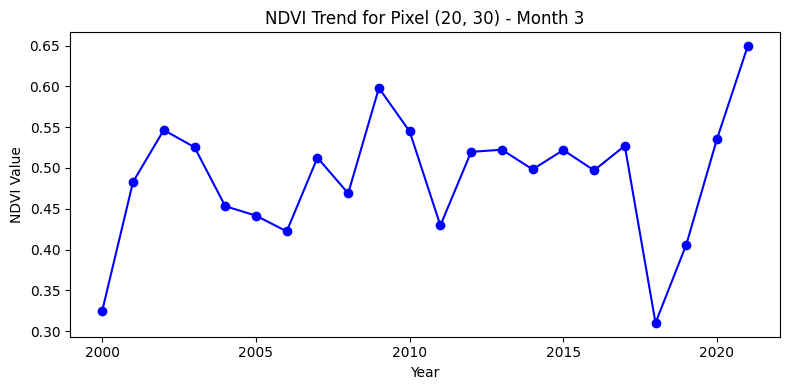

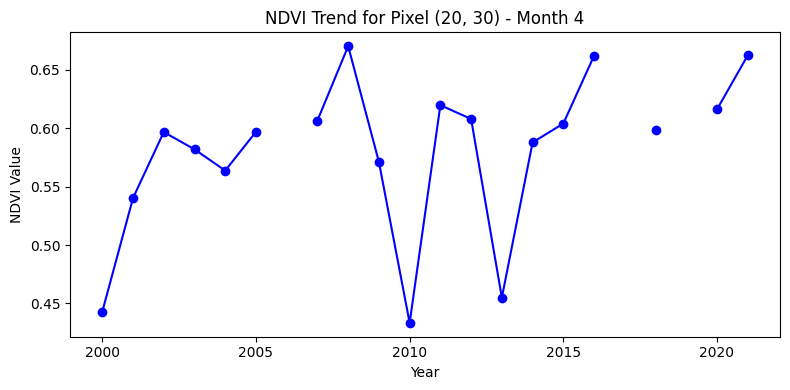

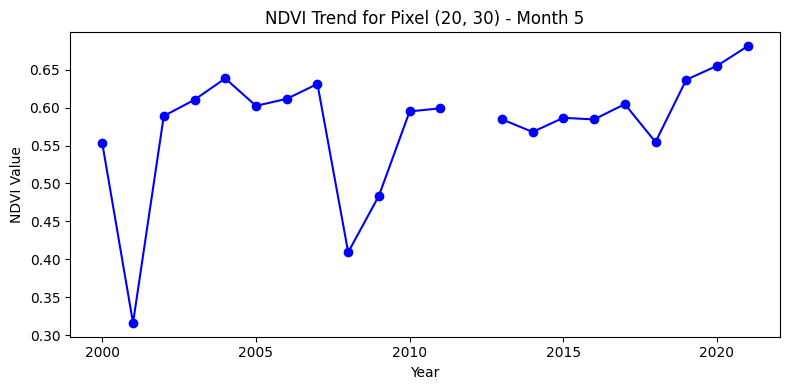

...

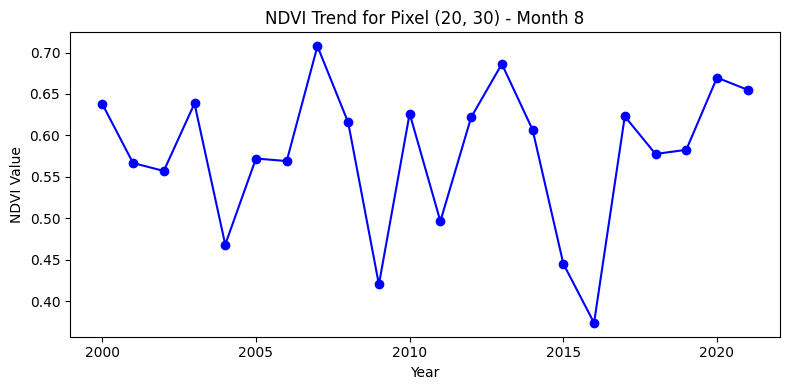

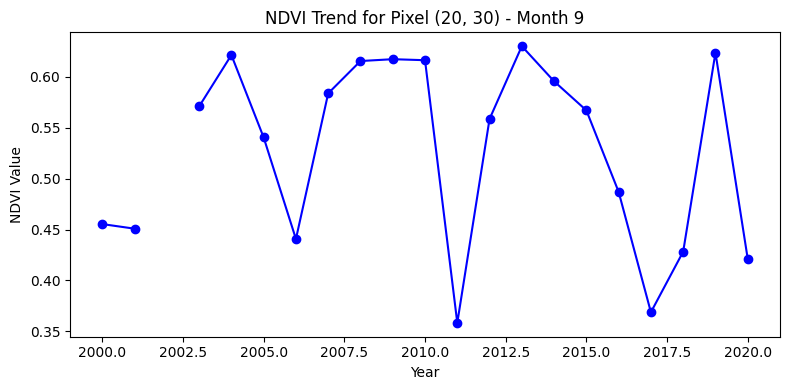

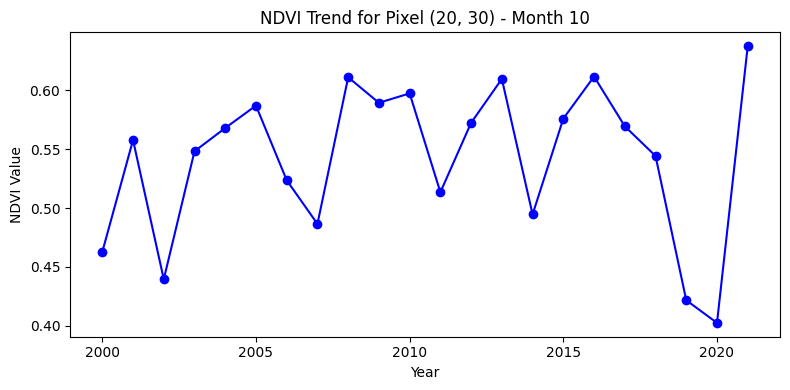

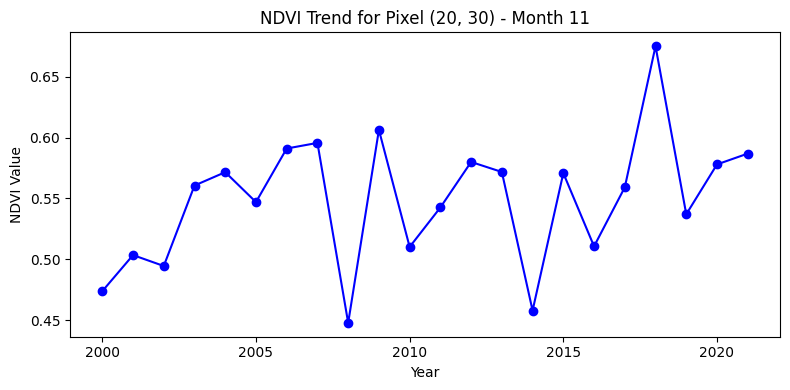

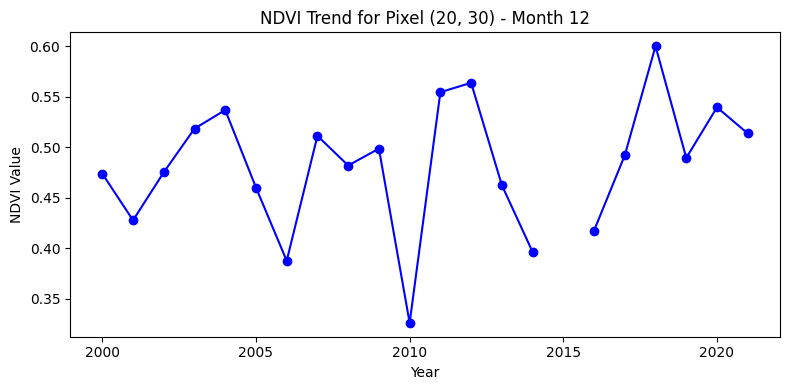

In [ ]:
# Choose a specific pixel location (replace these with the coordinates of the pixel you're interested in)
pixel_row = 20
pixel_col = 30

# Reshape the NDVI values to have one row per month over the 22 years
ndvi_values_reshaped = image_stack[pixel_row, pixel_col, :].reshape((22, 12))

# Plot the NDVI values for each month over the 22 years in separate graphs
for month in range(12):
    plt.figure(figsize=(8, 4))
    plt.plot(np.arange(2000, 2022), ndvi_values_reshaped[:, month], marker='o', linestyle='-', color='blue')

    # Add labels and title
    plt.title(f'NDVI Trend for Pixel ({pixel_row}, {pixel_col}) - Month {month + 1}')
    plt.xlabel('Year')
    plt.ylabel('NDVI Value')

    plt.tight_layout()
    plt.show()

There is a large variations in the montly trentds, here we are trying different ethods to make the monthly trend linear , that is without any variations

**Moving Window Average** : Here we are seeting the the window size which accordingly take the average and amoothns it


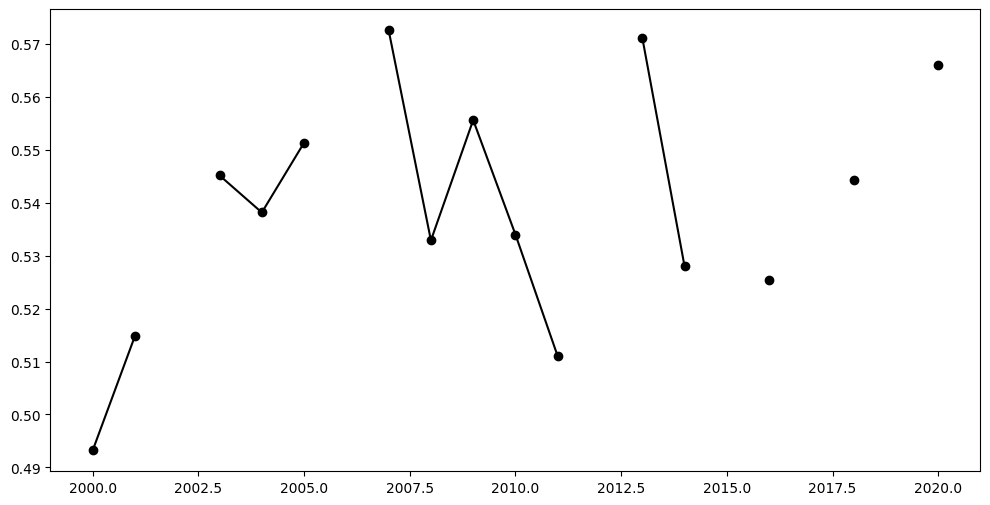

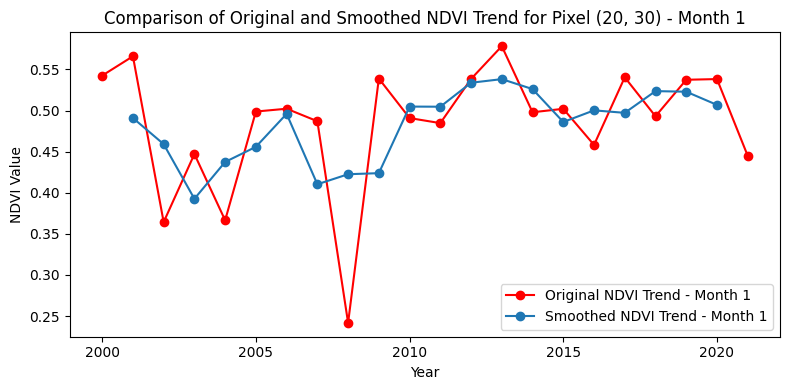

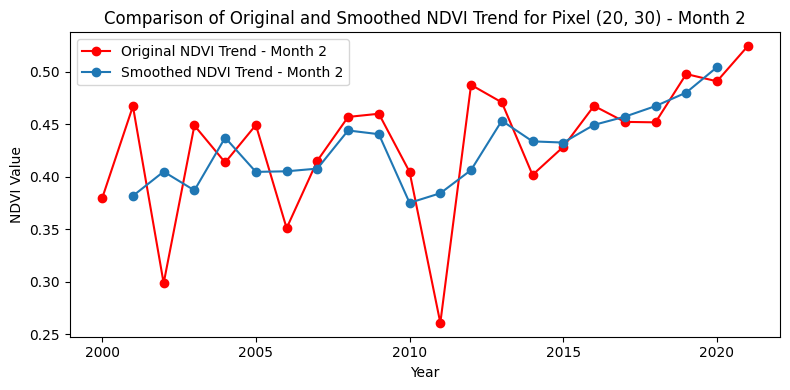

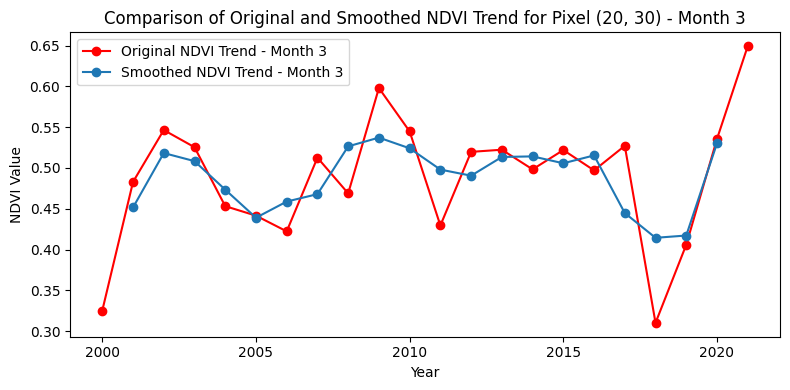

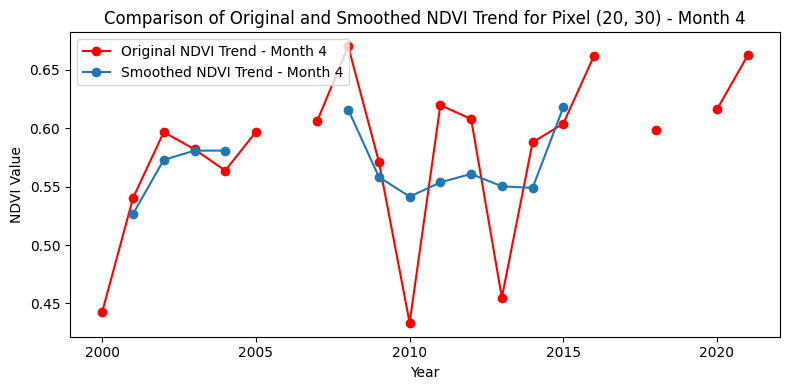

...

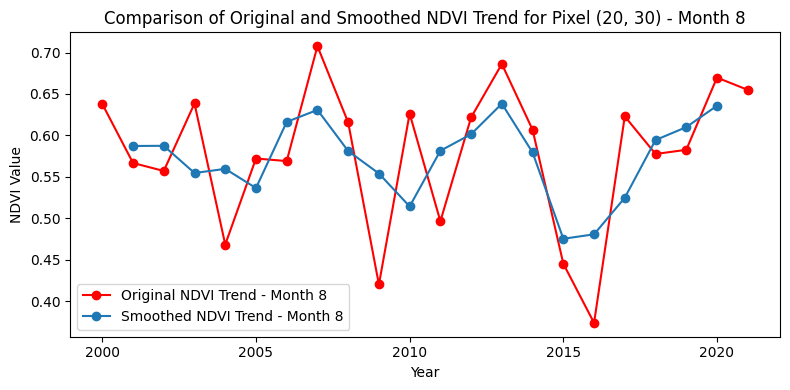

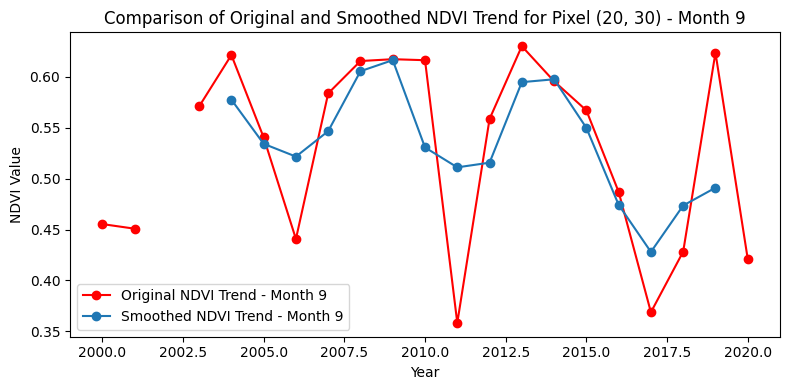

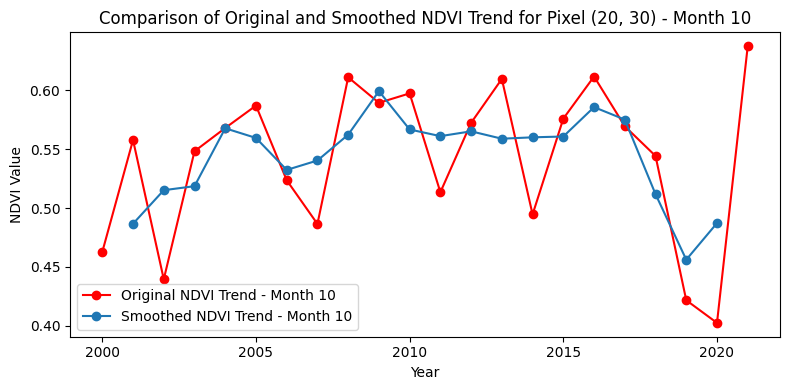

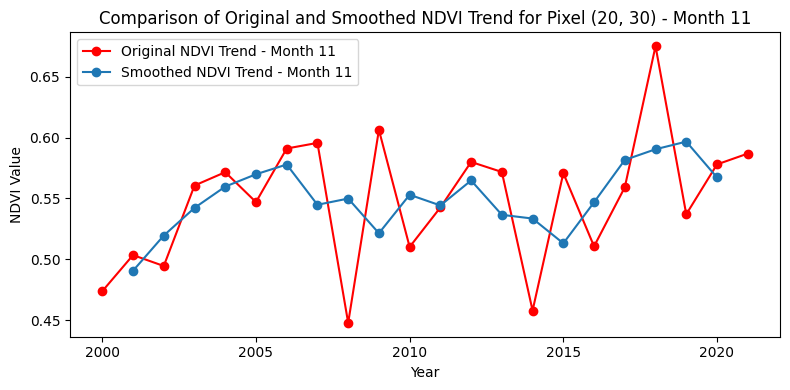

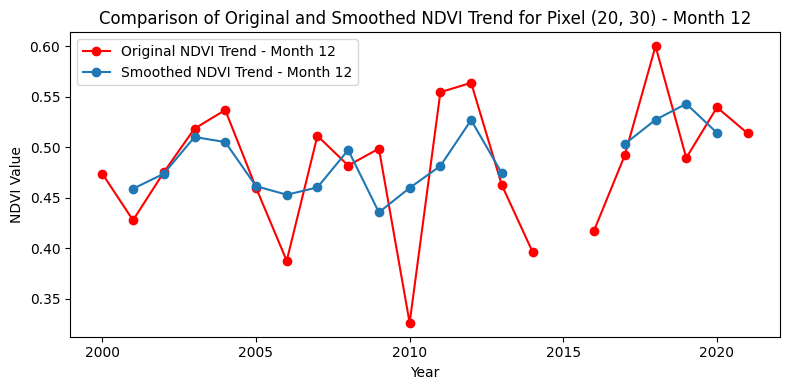

In [ ]:
# Choose a specific pixel location (replace these with the coordinates of the pixel you're interested in)
pixel_row = 20
pixel_col = 30

# Reshape the NDVI values to have one row per month over the 22 years
ndvi_values_reshaped = image_stack[pixel_row, pixel_col, :].reshape((22, 12))

# Plot the original NDVI trend using the mean of each month's values
plt.figure(figsize=(12, 6))
plt.plot(np.arange(2000, 2022), np.mean(ndvi_values_reshaped, axis=1), marker='o', linestyle='-', color='black', label='Original NDVI Trend')

# Plot the smoothed NDVI values for each month over the 22 years
for month in range(12):
    plt.figure(figsize=(8, 4))

    # Apply a simple moving average with a window size of 3
    window_size = 3
    smoothed_ndvi_values = np.convolve(ndvi_values_reshaped[:, month], np.ones(window_size)/window_size, mode='valid')

    # Plot the original NDVI trend
    plt.plot(np.arange(2000, 2022), ndvi_values_reshaped[:, month], marker='o', linestyle='-', color='red', label=f'Original NDVI Trend - Month {month + 1}')

    # Plot the smoothed NDVI values
    years = np.arange(2000 + (window_size // 2), 2022 - (window_size // 2))
    plt.plot(years, smoothed_ndvi_values, marker='o', linestyle='-', label=f'Smoothed NDVI Trend - Month {month + 1}')

    # Add labels and title
    plt.title(f'Comparison of Original and Smoothed NDVI Trend for Pixel ({pixel_row}, {pixel_col}) - Month {month + 1}')
    plt.xlabel('Year')
    plt.ylabel('NDVI Value')
    plt.legend()

    plt.tight_layout()
    plt.show()